# Anomalous Sound Detection of electrical engines
used dataset: [IDMT-ISA-Electric-Engine Dataset](https://zenodo.org/record/7551261#.ZGpAjyPP1D8)

**Table of Contents**

* [Creating Sound Dataset](#chapter1)  
* [CNN Autoencoder based on melspectrogram images](#chapter2)
* [CNN AE feature extraction](#chapter3)
* [Time-frequency domain feature extraction](#chapter4)
* [Deep anomaly detection models (DeepOD lib)](#chapter5)
    * [CNN AE features](#section_5_1)
    * [Time-frequency domain features](#section_5_2)
* [Classic anomaly detection models (PyOD)](#chapter6)
    * [CNN AE features](#section_6_1)
    * [Time-frequency domain features](#section_6_2)
* [Best results](#chapter7)

In [1]:
# unsupervised deep learning methods from DeepOD lib
from deepod.models.dsvdd import DeepSVDD
from deepod.models.rca import RCA
from deepod.models.neutral import NeuTraL
from deepod.models.rdp import RDP
from deepod.models.repen import REPEN
from deepod.models.icl import ICL

# weakly-supervised methods
from deepod.models.devnet import DevNet
from deepod.models.dsad import DeepSAD
from deepod.models.prenet import PReNet
import deepod.utils as utils

# unsupervised classic methods from PyOD lib
from pyod.models.iforest import IForest
from pyod.models.knn import KNN
from pyod.models.lof import LOF
from pyod.models.gmm import GMM
from pyod.models.ocsvm import OCSVM
from pyod.models.inne import INNE
from pyod.models.copod import COPOD
from pyod.models.cblof import CBLOF
from pyod.models.ecod import ECOD

import plotly.graph_objects as go
import plotly.express as px
import pandas as pd
import numpy as np
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
import torch
from torch import nn
from torch.utils.data import Dataset, TensorDataset, DataLoader
from torch.autograd import Variable
from torch.optim import Adam
import matplotlib.pyplot as plt
import warnings

from cnn_ae import CNNAutoEncoder

pd.set_option('max_colwidth',120)
warnings.filterwarnings('ignore')

## Creating Sound Dataset <a class="anchor" id="chapter1"></a>

In [2]:
from electric_engine import ElEngine

# data dir
target_dir = r'datasets\el_engine'

# train normal data (few amount for weakly-supervised models)
train_dir_name_normal = r'\train_normal'
# train anomalous data (few amount for weakly-supervised models ~0.5%)
train_dir_name_anomaly = r'\train_anomal'
# test normal data
test_dir_name_normal = r'\test_normal'
# test anomalous data
test_dir_name_anomaly = r'\test_anomal'


dataset_train = ElEngine(target_dir, train_dir_name_normal, train_dir_name_anomaly, extraction_type='melspectrogram')
dataset_test = ElEngine(target_dir, test_dir_name_normal, test_dir_name_anomaly, extraction_type='melspectrogram')

100%|██████████| 1588/1588 [02:17<00:00, 11.51it/s]


In [3]:
def normalize(X):
    # Normalize to range from [-80, 0] to [0, 1] based on dataset.
    X = (X + 80.) / (1. + 80.)
    X = np.clip(X, 0., 1.)
    return X

## CNN Autoencoder <a class="anchor" id="chapter2"></a>

In [4]:
EPOCHS = 50
LEARNING_RATE = 0.001
SAMPLE_RATE = 22050
NUM_SAMPLES = 22050
device='cpu'

cnn = CNNAutoEncoder()
BATCH_SIZE = 128
losses=[]

def create_data_loader(train_data, batch_size):
    train_dataloader = DataLoader(train_data, batch_size=batch_size)
    return train_dataloader


def train_single_epoch(model, data_loader, loss_fn, optimiser, device):
    for input, target in data_loader:
        input = normalize(input)
        input, target = input.to(device), target.to(device)
        input = torch.tensor(input, dtype=torch.float32)
        target = torch.tensor(target, dtype=torch.float32)

        # calculate loss
        prediction = model(input)[0]
        loss = loss_fn(prediction, input)

        # backpropagate error and update weights
        optimiser.zero_grad()
        loss.backward()
        optimiser.step()

    print(f"loss: {loss.item()}")
    losses.append(loss.item())


def train(model, data_loader, loss_fn, optimiser, device, epochs):
    for i in range(epochs):
        print(f"Epoch {i+1}")
        train_single_epoch(model, data_loader, loss_fn, optimiser, device)
        print("---------------------------")
    print("Finished training")

In [5]:
train_dataloader = create_data_loader(dataset_train, BATCH_SIZE)

# construct model and assign it to device
cnn = CNNAutoEncoder().to(device)
print(cnn)

# initialise loss funtion + optimiser
loss_fn = nn.MSELoss()
optimiser = torch.optim.Adam(cnn.parameters(),
                                lr=LEARNING_RATE)

# train model
train(cnn, train_dataloader, loss_fn, optimiser, device, EPOCHS)

# save model
torch.save(cnn.state_dict(), "CNNAE_el_engine.pth")
print("Trained CNNAE net saved at CNNAE_el_engine.pth")

CNNAutoEncoder(
  (conv1): Sequential(
    (0): ZeroPad2d((1, 2, 1, 2))
    (1): Conv2d(1, 32, kernel_size=(5, 5), stride=(2, 2))
    (2): ReLU()
  )
  (conv2): Sequential(
    (0): ZeroPad2d((1, 2, 1, 2))
    (1): Conv2d(32, 64, kernel_size=(5, 5), stride=(2, 2))
    (2): ReLU()
    (3): Dropout(p=0.2, inplace=False)
  )
  (conv3): Sequential(
    (0): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU()
    (2): Dropout(p=0.3, inplace=False)
  )
  (conv4): Sequential(
    (0): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2))
    (1): ReLU()
    (2): Dropout(p=0.3, inplace=False)
  )
  (fc1): Conv2d(256, 40, kernel_size=(3, 3), stride=(1, 1))
  (flatten): Flatten(start_dim=1, end_dim=-1)
  (linear): Linear(in_features=4840, out_features=256, bias=True)
  (linear2): Linear(in_features=256, out_features=4840, bias=True)
  (unflatten): Unflatten(dim=1, unflattened_size=(40, 11, 11))
  (fc2): Sequential(
    (0): ConvTranspose2d(40, 256, kernel_size=(3, 3), stride=(1, 1))

In [6]:
cnn = CNNAutoEncoder()
state_dict = torch.load("CNNAE_el_engine.pth")
cnn.load_state_dict(state_dict)

<All keys matched successfully>

In [7]:
fig = px.line(losses, title=f'Loss')
fig.show()

In [8]:
def predict(model, input):
    model.eval()
    with torch.no_grad():

        input = torch.tensor(input, dtype=torch.float32)
        input.unsqueeze_(0)
        yhat = model(input)[0].cpu().detach().numpy().reshape(input.shape)
        features = model(input)[1].cpu().detach().numpy()
        errors = torch.mean(np.square(input - yhat), axis=1)
       
    return torch.mean(errors), features, yhat

In [9]:
# Feature representation and Anomaly score for train data

scores_train = []
features_train = []
for x, fname in zip(dataset_train.data, dataset_train.file_list):
    x = normalize(x)
    anomaly_score, features, _ = predict(cnn, x)
    scores_train.append((str(fname), float(anomaly_score), features.flatten()))
    features_train = np.concatenate([features_train,features.flatten()])

In [10]:
data = pd.DataFrame(dataset_test.file_list, columns=['file_name'])
data['target'] = dataset_test.labels
normal_test_example = data[data['target']==0][25:27]
anomal_test_example = data[data['target']==1][35:37]

Normal examplesc:\Users\alina\Thesis\Диплом\datasets\el_engine\test_normal\atmo_high_59_heavyload.wav
Normal examplesc:\Users\alina\Thesis\Диплом\datasets\el_engine\test_normal\atmo_high_60.wav
Anomal examplec:\Users\alina\Thesis\Диплом\datasets\el_engine\test_anomal\atmo_high_40.wav
Anomal examplec:\Users\alina\Thesis\Диплом\datasets\el_engine\test_anomal\atmo_high_41.wav


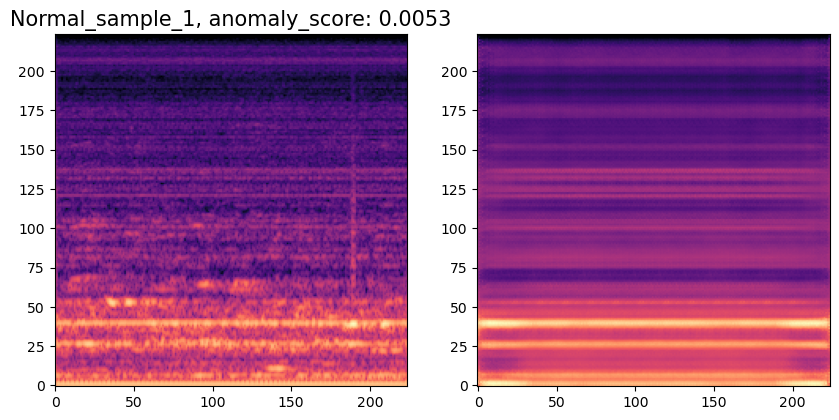

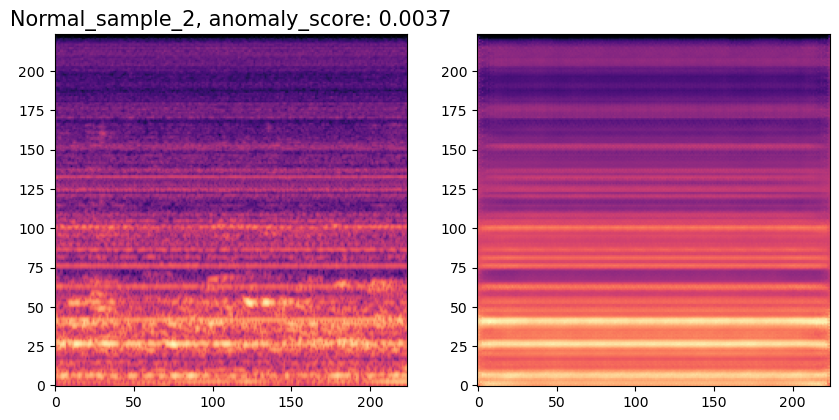

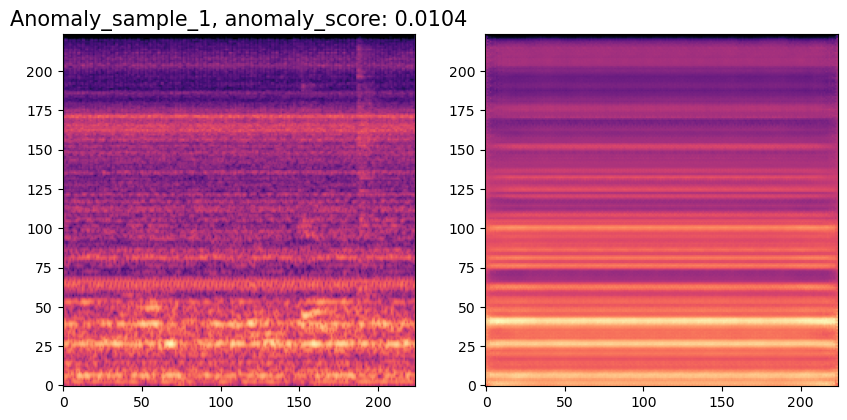

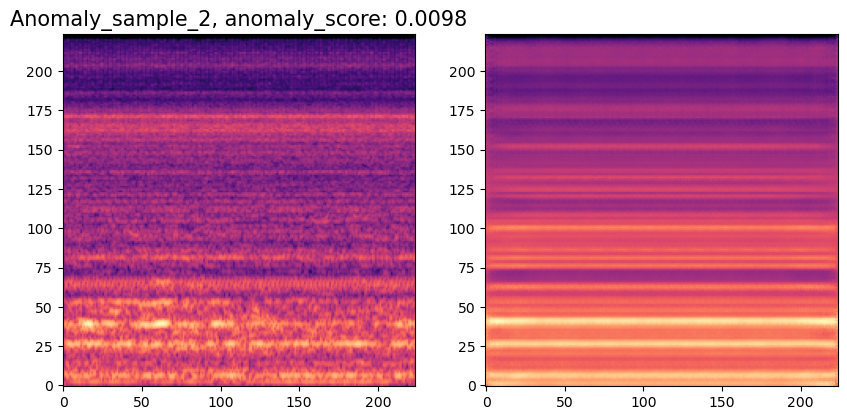

In [11]:
# Anomaly score for test anomalies and plot some normal and anomalius examples from test data

scores_test = []
features_test = []
i = 1
j = 1
for x, fname in zip(dataset_test.data, dataset_test.file_list):
    x = normalize(x)
    anomaly_score, features, yhat = predict(cnn, x)
    if fname in anomal_test_example['file_name'].values:
        print(f'Anomal example{fname}')
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(x.reshape(224,224,1), origin='lower', cmap='magma' )
        axs[0].set_title(f'Anomaly_sample_{i}, anomaly_score: {round(float(anomaly_score),4)}', fontsize=15)
        axs[1].imshow(yhat.reshape(224,224,1), origin='lower', cmap='magma')
        fig.show()
        i+=1
          
    if fname in normal_test_example['file_name'].values:
        print(f'Normal examples{fname}')
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(x.reshape(224,224,1), origin='lower', cmap='magma')
        axs[0].set_title(f'Normal_sample_{j}, anomaly_score: {round(float(anomaly_score), 4)}', fontsize=15)
        axs[1].imshow(yhat.reshape(224,224,1), origin='lower', cmap='magma')
        fig.show()
        j+=1

    scores_test.append((str(fname), float(anomaly_score), features.flatten()))
    features_test = np.concatenate([features_test,features.flatten()])


In [12]:
test_scores = pd.DataFrame(scores_test)
train_scores = pd.DataFrame(scores_train)
train_scores['target_name'] = 'train_normal'
train_scores['target'] = dataset_train.labels
test_scores['target'] = dataset_test.labels
test_scores['target_name'] = np.where(test_scores['target']==1, 'test_anomal', 'test_normal')
ttl_scores = pd.concat([train_scores, test_scores]).rename(columns={1:'score'})

In [13]:
fig = px.violin(ttl_scores, y='score', x="target_name", box=True, color="target_name", points="all",
          hover_data=ttl_scores.columns, title=f'Distribution of anomaly scores ',
          labels={
                     'score': "anomaly_score",
                     "target_name": "class labels",   
                 },width=700)
fig.update_layout(legend=dict(
    orientation='h',
    yanchor='top',
    y=0.99,
    xanchor='left',
    x=0.16
),
title=dict(#yanchor='top',
    y=0.85,
    xanchor='center',
    x=0.5,
    font=dict(size=25) 
))
fig.show()

## CNN AE feature extraction <a class="anchor" id="chapter3"></a>

In [14]:
anomaly_scores = pd.DataFrame(features_train.reshape(dataset_train.data.shape[0], 256))
anomaly_scores['file_name'] = dataset_train.file_list
anomaly_scores['file_name'] = anomaly_scores['file_name'].astype(str)
anomaly_scores['target'] = train_scores['target']#'normal'
anomaly_scores['score'] = train_scores[1]#'normal'
anomaly_scores_test = pd.DataFrame(features_test.reshape(dataset_test.data.shape[0], 256))
anomaly_scores_test['file_name'] = dataset_test.file_list
anomaly_scores_test['file_name'] = anomaly_scores_test['file_name'].astype(str)
anomaly_scores_test['target'] = test_scores['target']#'anomaly'
anomaly_scores_test['score'] = test_scores[1]#'normal'
cnn_features = pd.concat([anomaly_scores, anomaly_scores_test]).reset_index(drop=True)
cnn_features.head()

,0,1,2,3,4,5,6,7,8,9,...,249,250,251,252,253,254,255,file_name,target,score
0,0.375728,0.104058,-0.793494,1.237962,0.112737,-0.334461,-0.973563,0.631849,0.238774,-2.396492,...,-0.718653,1.785868,0.066701,0.124893,-0.189913,0.031021,-0.874793,c:\Users\alina\Thesis\Диплом\datasets\el_engine\train_normal\atmo_high_0.wav,0.0,0.003363
1,-0.205058,-0.513616,-0.848802,1.504926,0.573808,0.273123,-1.171374,1.054999,0.506675,-2.942789,...,-0.759525,2.113822,0.657402,-0.307825,0.422619,0.666453,-1.064553,c:\Users\alina\Thesis\Диплом\datasets\el_engine\train_normal\atmo_high_0_heavyload.wav,0.0,0.010774
2,0.388985,0.211962,-0.493728,0.841686,-0.002807,-0.295396,-0.645586,0.523249,0.087679,-1.808229,...,-0.599284,1.349171,-0.199151,0.205457,-0.448978,-0.209417,-0.566947,c:\Users\alina\Thesis\Диплом\datasets\el_engine\train_normal\atmo_high_1.wav,0.0,0.003526
3,0.333055,0.048299,-0.834059,1.302783,0.159209,-0.292863,-1.025008,0.673487,0.273879,-2.496846,...,-0.739789,1.856619,0.134560,0.082856,-0.124820,0.099953,-0.923659,c:\Users\alina\Thesis\Диплом\datasets\el_engine\train_normal\atmo_high_10.wav,0.0,0.003894
4,-0.108752,-0.425635,-0.883523,1.527398,0.563565,0.201589,-1.195626,1.040218,0.509077,-2.856912,...,-0.834039,2.087956,0.557855,-0.273195,0.277810,0.554468,-1.091582,c:\Users\alina\Thesis\Диплом\datasets\el_engine\train_normal\atmo_high_10_heavyload.wav,0.0,0.006078


In [15]:
cnn_features['mode'] = cnn_features['file_name'].str[48:53]
train_ae = cnn_features[cnn_features['mode']=='train']
test_ae = cnn_features[cnn_features['mode']=='test_']

X_test_ae = test_ae.drop(['file_name', 'target', 'mode', 'score'], axis=1).values
y_test_ae = test_ae['target'].values
test_file_names = test_ae['file_name'].astype(str).values

X_train_ae = train_ae.drop(['file_name', 'target', 'mode', 'score'], axis=1).values
y_train_ae = train_ae['target'].values
train_file_names = train_ae['file_name'].astype(str).values

In [16]:
def evaluate(y_true, scores):
    """calculate evaluation metrics"""
    roc_auc = metrics.roc_auc_score(y_true, scores)
    ap = metrics.average_precision_score(y_true, scores)

    # F1@k, using real percentage to calculate F1-score
    ratio = 100.0 * len(np.where(y_true==0)[0]) / len(y_true)
    thresh = np.percentile(scores, ratio)
    y_pred = (scores >= thresh).astype(int)
    y_true = y_true.astype(int)
    precision, recall, f_score, support = metrics.precision_recall_fscore_support(y_true, y_pred, average='binary')

    return y_pred, f_score, precision, recall, ap, roc_auc

In [17]:
y_pred, f_score, precision, recall, ap, roc_auc = evaluate(test_ae['target'].values, test_ae['score'].values)
print(f'f_score: {f_score:0.2f} \n precision: {precision:0.2f} \n recall: {recall:0.2f} \n ap: {ap:0.2f} \n roc_auc: {roc_auc:0.2f}')

f_score: 0.96 
 precision: 0.96 
 recall: 0.96 
 ap: 0.97 
 roc_auc: 0.99


## Time-frequency domain feature extraction <a class="anchor" id="chapter4"></a>

In [18]:
from electric_engine import ElEngine

# data dir
target_dir = r'datasets\el_engine'

# train normal data (few amount for weakly-supervised models)
train_dir_name_normal = r'\train_normal'
# train anomalous data (few amount for weakly-supervised models ~0.5%)
train_dir_name_anomaly = r'\train_anomal'
# test normal data
test_dir_name_normal = r'\test_normal'
# test anomalous data
test_dir_name_anomaly = r'\test_anomal'


dataset_train = ElEngine(target_dir, train_dir_name_normal, train_dir_name_anomaly, n_mfcc=20, extraction_type='aggregate_features')
dataset_test = ElEngine(target_dir, test_dir_name_normal, test_dir_name_anomaly, n_mfcc=20, extraction_type='aggregate_features')

100%|██████████| 1588/1588 [03:22<00:00,  7.83it/s]


In [19]:
X_train_ts = dataset_train.data
y_train_ts = dataset_train.labels

X_test_ts = dataset_test.data
y_test_ts = dataset_test.labels

## Deep Anomaly detection models from DeepOD lib <a class="anchor" id="chapter5"></a>

In [20]:
epochs = 100
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

models = {'NeuTraL': NeuTraL(epochs=epochs, device=device),
          'PreNet' : PReNet(epochs=epochs, device=device),
          'RDP'    : RDP(epochs=epochs, device=device),
          'REPEN' : REPEN(epochs=epochs, device=device),
          'DevNet' : DevNet(epochs=500, device=device),
          'DeepSAD' : DeepSAD(epochs=epochs, device=device),
          'DeepSVDD' : DeepSVDD(epochs=epochs, device=device),
          #'AnoGan' : AnoGAN(epochs=epochs, device=device),
          'ICL' : ICL(epochs=epochs, device=device),
          'RCA' : RCA(epochs=epochs, device=device) 
}


In [21]:
def deep_ad_results(X_train, y_train, X_test, y_test, test_file_names):
    global models, epochs, device 
    results = []
    for model_name, model in models.items():
        print(f'\n {model_name} \n')
        clf = models[model_name]
        if model_name in ['DevNet', 'DeepSAD', 'PreNet']:
            y = np.array(y_train)
        else:
            y = None
        clf.fit(np.array(X_train), y=y)#None)#np.array(y_train))
        scores = clf.decision_function(np.array(X_test))
        model_scores = pd.DataFrame(scores, columns=['anomaly_score'])
        model_scores['target'] = y_test#.values
        model_scores['target_name'] = np.where(model_scores['target']==1, 'Anomal', 'Normal')
        model_scores['file_name'] = test_file_names
        model_scores['file_name'] = model_scores['file_name'].astype(str)
        model_scores['model'] = model_name
        model_scores['score'] = (model_scores['anomaly_score'] - model_scores['anomaly_score'].min()) / (model_scores['anomaly_score'].max() - model_scores['anomaly_score'].min())

        # evaluation
        y_pred, f_score, precision, recall, ap, roc_auc = evaluate(y_test, scores)

        fig = px.violin(model_scores, y="score", x="target_name", box=True, color="target_name", points="all",
            hover_data=model_scores.columns, title=f'Distribution of anomaly scores (model: {model_scores["model"].values[0]})',
            labels={
                        "score": "anomaly_score",
                        "target_name": "class label",
                        
                    },width=750)
        fig.update_layout(legend=dict(yanchor='top',
            orientation='h',
            y=0.99,
            xanchor='left',
            x=0.01
        ),
        title=dict(#yanchor='top',
            y=0.85,
            xanchor='center',
            x=0.5,
            font=dict(size=20) 
        ))
        fig.show()
        
        print(f'Model: {model_name} \n f_score: {f_score:.3f} \n precision: {precision:.3f} \n recall: {recall:.3f} \n ap: {ap:.3f} \n roc_auc: {roc_auc:.3f}')
        results.append((model_name , f_score, precision, recall, ap, roc_auc))

    return results

### Deep Anomaly detection using CNN AE features <a class="anchor" id="section_5_1"></a>

In [22]:
results_ae = deep_ad_results(X_train_ae, y_train_ae, X_test_ae, y_test_ae, dataset_test.file_list)


 NeuTraL 

Start Training...
ensemble size: 1
epoch1, training loss: 0.360607, time: 0.1s
epoch10, training loss: 0.134628, time: 0.1s
epoch20, training loss: 0.134249, time: 0.1s
epoch30, training loss: 0.134154, time: 0.1s
epoch40, training loss: 0.134113, time: 0.1s
epoch50, training loss: 0.134095, time: 0.1s
epoch60, training loss: 0.134083, time: 0.1s
epoch70, training loss: 0.134070, time: 0.1s
epoch80, training loss: 0.134067, time: 0.1s
epoch90, training loss: 0.134074, time: 0.1s
epoch100, training loss: 0.134065, time: 0.1s
Start Inference on the training data...


Model: NeuTraL 
 f_score: 0.595 
 precision: 0.595 
 recall: 0.595 
 ap: 0.756 
 roc_auc: 0.767

 PreNet 

Start Training...
ensemble size: 1
epoch1, training loss: 2.858946, time: 0.0s
epoch10, training loss: 2.015161, time: 0.0s
epoch20, training loss: 1.060911, time: 0.0s
epoch30, training loss: 0.579137, time: 0.0s
epoch40, training loss: 0.536148, time: 0.0s
epoch50, training loss: 0.421930, time: 0.0s
epoch60, training loss: 0.453239, time: 0.0s
epoch70, training loss: 0.259378, time: 0.0s
epoch80, training loss: 0.351044, time: 0.0s
epoch90, training loss: 0.504331, time: 0.0s
epoch100, training loss: 0.228127, time: 0.0s
Start Inference on the training data...


Model: PreNet 
 f_score: 0.911 
 precision: 0.911 
 recall: 0.911 
 ap: 0.963 
 roc_auc: 0.952

 RDP 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=256, out_features=100, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=128, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 0.000149, time: 0.0s
epoch10, training loss: 0.000002, time: 0.0s
epoch20, training loss: 0.000002, time: 0.0s
epoch30, training loss: 0.000003, time: 0.0s
epoch40, training loss: 0.000003, time: 0.0s
epoch50, training loss: 0.000004, time: 0.0s
epoch60, training loss: 0.000004, time: 0.0s
epoch70, training loss: 0.000004, time: 0.0s
epoch80, training loss: 0.000004, time: 0.

Model: RDP 
 f_score: 0.544 
 precision: 0.544 
 recall: 0.544 
 ap: 0.609 
 roc_auc: 0.661

 REPEN 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=256, out_features=100, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=1, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 999.455927, time: 0.1s
epoch10, training loss: 118.471013, time: 0.1s
epoch20, training loss: 90.939386, time: 0.1s
epoch30, training loss: 53.696479, time: 0.1s
epoch40, training loss: 67.090956, time: 0.1s
epoch50, training loss: 71.659714, time: 0.1s
epoch60, training loss: 83.357415, time: 0.1s
epoch70, training loss: 57.822157, time: 0.1s
epoch80, training loss: 36.919722, 

Model: REPEN 
 f_score: 0.083 
 precision: 0.083 
 recall: 0.083 
 ap: 0.284 
 roc_auc: 0.217

 DevNet 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=256, out_features=100, bias=False)
      (act_layer): ReLU()
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): ReLU()
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=1, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 2.522209, time: 0.0s
epoch10, training loss: 2.293548, time: 0.0s
epoch20, training loss: 2.380307, time: 0.0s
epoch30, training loss: 2.879164, time: 0.0s
epoch40, training loss: 2.590151, time: 0.0s
epoch50, training loss: 2.624374, time: 0.0s
epoch60, training loss: 2.554531, time: 0.0s
epoch70, training loss: 2.500000, time: 0.0s
epoch80, training loss: 2.501004, time: 0.0s
epoch90, training loss: 2.516756, time: 0.0s


Model: DevNet 
 f_score: 0.749 
 precision: 0.749 
 recall: 0.749 
 ap: 0.797 
 roc_auc: 0.846

 DeepSAD 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=256, out_features=100, bias=False)
      (act_layer): ReLU()
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): ReLU()
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=128, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 0.362643, time: 0.0s
epoch10, training loss: 0.174312, time: 0.0s
epoch20, training loss: 0.138073, time: 0.0s
epoch30, training loss: 0.117931, time: 0.0s
epoch40, training loss: 0.095827, time: 0.0s
epoch50, training loss: 0.124173, time: 0.0s
epoch60, training loss: 0.107850, time: 0.0s
epoch70, training loss: 0.076425, time: 0.0s
epoch80, training loss: 0.076202, time: 0.0s
epoch90, training loss: 0.066540, time: 0

Model: DeepSAD 
 f_score: 0.871 
 precision: 0.871 
 recall: 0.871 
 ap: 0.954 
 roc_auc: 0.968

 DeepSVDD 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=256, out_features=100, bias=False)
      (act_layer): ReLU()
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): ReLU()
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=128, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 0.293299, time: 0.0s
epoch10, training loss: 0.000846, time: 0.0s
epoch20, training loss: 0.000584, time: 0.0s
epoch30, training loss: 0.000263, time: 0.0s
epoch40, training loss: 0.000574, time: 0.0s
epoch50, training loss: 0.000437, time: 0.0s
epoch60, training loss: 0.000181, time: 0.0s
epoch70, training loss: 0.000251, time: 0.0s
epoch80, training loss: 0.000185, time: 0.0s
epoch90, training loss: 0.000184, time:

Model: DeepSVDD 
 f_score: 0.528 
 precision: 0.528 
 recall: 0.528 
 ap: 0.699 
 roc_auc: 0.650

 ICL 

Start Training...
ensemble size: 1
kernel size: 56
ICLNet(
  (enc_f_net): MLPnet(
    (network): Sequential(
      (0): LinearBlock(
        (linear): Linear(in_features=200, out_features=100, bias=False)
        (act_layer): Tanh()
        (bn_layer): BatchNorm1d(201, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
      )
      (1): LinearBlock(
        (linear): Linear(in_features=100, out_features=50, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (bn_layer): BatchNorm1d(201, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
      )
      (2): LinearBlock(
        (linear): Linear(in_features=50, out_features=128, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (bn_layer): BatchNorm1d(201, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
      )
    )
  )
  (enc_g_net): MLPnet(
    (

Model: ICL 
 f_score: 0.583 
 precision: 0.583 
 recall: 0.583 
 ap: 0.681 
 roc_auc: 0.688

 RCA 

Start Training...
ensemble size: 1
RCANet(
  (enc1): MLPnet(
    (network): Sequential(
      (0): LinearBlock(
        (linear): Linear(in_features=256, out_features=100, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (dropout_layer): Dropout(p=0.5, inplace=False)
      )
      (1): LinearBlock(
        (linear): Linear(in_features=100, out_features=50, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (dropout_layer): Dropout(p=0.5, inplace=False)
      )
      (2): LinearBlock(
        (linear): Linear(in_features=50, out_features=128, bias=False)
        (act_layer): Identity()
      )
    )
  )
  (enc2): MLPnet(
    (network): Sequential(
      (0): LinearBlock(
        (linear): Linear(in_features=256, out_features=100, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (dropout_layer): Dropout(p=0.5, inplace=False

100%|██████████| 10/10 [00:00<00:00, 29.99it/s]


Model: RCA 
 f_score: 0.370 
 precision: 0.370 
 recall: 0.370 
 ap: 0.490 
 roc_auc: 0.419


In [23]:
pd.DataFrame(results_ae)

,0,1,2,3,4,5
0,NeuTraL,0.595489,0.595489,0.595489,0.755899,0.767350
1,PreNet,0.911278,0.911278,0.911278,0.962565,0.951536
2,RDP,0.544361,0.544361,0.544361,0.608918,0.661418
3,REPEN,0.082707,0.082707,0.082707,0.284327,0.217173
4,DevNet,0.748872,0.748872,0.748872,0.796770,0.845875
5,DeepSAD,0.870677,0.870677,0.870677,0.954436,0.968423
6,DeepSVDD,0.527820,0.527820,0.527820,0.699163,0.649746
7,ICL,0.583459,0.583459,0.583459,0.680519,0.688420
8,RCA,0.369925,0.369925,0.369925,0.489971,0.419401


### Deep Anomaly detection using audio Time-frequency domain features <a class="anchor" id="section_5_2"></a>

In [24]:
results_ts = deep_ad_results(X_train_ts, y_train_ts, X_test_ts, y_test_ts, dataset_test.file_list)


 NeuTraL 

Start Training...
ensemble size: 1
epoch1, training loss: 0.492509, time: 0.1s
epoch10, training loss: 0.134840, time: 0.1s
epoch20, training loss: 0.134328, time: 0.1s
epoch30, training loss: 0.134205, time: 0.1s
epoch40, training loss: 0.134153, time: 0.1s
epoch50, training loss: 0.134118, time: 0.1s
epoch60, training loss: 0.134101, time: 0.2s
epoch70, training loss: 0.134090, time: 0.1s
epoch80, training loss: 0.134081, time: 0.1s
epoch90, training loss: 0.134074, time: 0.1s
epoch100, training loss: 0.134070, time: 0.1s
Start Inference on the training data...


Model: NeuTraL 
 f_score: 0.935 
 precision: 0.935 
 recall: 0.935 
 ap: 0.973 
 roc_auc: 0.986

 PreNet 

Start Training...
ensemble size: 1
epoch1, training loss: 14.869210, time: 0.0s
epoch10, training loss: 0.522749, time: 0.0s
epoch20, training loss: 0.311052, time: 0.0s
epoch30, training loss: 0.160481, time: 0.0s
epoch40, training loss: 0.494959, time: 0.0s
epoch50, training loss: 0.348968, time: 0.0s
epoch60, training loss: 0.077704, time: 0.0s
epoch70, training loss: 0.082796, time: 0.0s
epoch80, training loss: 0.072234, time: 0.0s
epoch90, training loss: 0.089973, time: 0.0s
epoch100, training loss: 0.277448, time: 0.0s
Start Inference on the training data...


Model: PreNet 
 f_score: 1.000 
 precision: 1.000 
 recall: 1.000 
 ap: 1.000 
 roc_auc: 1.000

 RDP 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=97, out_features=100, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=128, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 49.821633, time: 0.0s
epoch10, training loss: 0.261919, time: 0.0s
epoch20, training loss: 0.207133, time: 0.0s
epoch30, training loss: 0.409539, time: 0.0s
epoch40, training loss: 0.189737, time: 0.0s
epoch50, training loss: 0.274247, time: 0.0s
epoch60, training loss: 0.193536, time: 0.0s
epoch70, training loss: 0.233941, time: 0.0s
epoch80, training loss: 0.248591, time: 0.

Model: RDP 
 f_score: 0.901 
 precision: 0.901 
 recall: 0.901 
 ap: 0.880 
 roc_auc: 0.952

 REPEN 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=97, out_features=100, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): LeakyReLU(negative_slope=0.01)
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=1, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 503.081995, time: 0.1s
epoch10, training loss: 68.437514, time: 0.1s
epoch20, training loss: 50.573458, time: 0.1s
epoch30, training loss: 26.547118, time: 0.1s
epoch40, training loss: 25.931836, time: 0.1s
epoch50, training loss: 26.407419, time: 0.1s
epoch60, training loss: 44.926194, time: 0.1s
epoch70, training loss: 15.150782, time: 0.1s
epoch80, training loss: 50.718679, ti

Model: REPEN 
 f_score: 0.588 
 precision: 0.588 
 recall: 0.588 
 ap: 0.610 
 roc_auc: 0.670

 DevNet 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=97, out_features=100, bias=False)
      (act_layer): ReLU()
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): ReLU()
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=1, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 96.099838, time: 0.0s
epoch10, training loss: 11.896967, time: 0.0s
epoch20, training loss: 4.901063, time: 0.0s
epoch30, training loss: 3.333577, time: 0.0s
epoch40, training loss: 3.874224, time: 0.0s
epoch50, training loss: 2.667550, time: 0.0s
epoch60, training loss: 2.864574, time: 0.0s
epoch70, training loss: 2.809808, time: 0.0s
epoch80, training loss: 2.453092, time: 0.0s
epoch90, training loss: 3.063580, time: 0.0s

Model: DevNet 
 f_score: 0.704 
 precision: 0.704 
 recall: 0.704 
 ap: 0.771 
 roc_auc: 0.815

 DeepSAD 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=97, out_features=100, bias=False)
      (act_layer): ReLU()
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): ReLU()
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=128, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 54532.742898, time: 0.0s
epoch10, training loss: 2004.445368, time: 0.0s
epoch20, training loss: 830.001265, time: 0.0s
epoch30, training loss: 514.690083, time: 0.0s
epoch40, training loss: 577.206044, time: 0.0s
epoch50, training loss: 352.597923, time: 0.0s
epoch60, training loss: 313.476232, time: 0.0s
epoch70, training loss: 205.466921, time: 0.0s
epoch80, training loss: 191.324484, time: 0.0s
epoch90, training los

Model: DeepSAD 
 f_score: 0.884 
 precision: 0.884 
 recall: 0.884 
 ap: 0.941 
 roc_auc: 0.965

 DeepSVDD 

Start Training...
ensemble size: 1
MLPnet(
  (network): Sequential(
    (0): LinearBlock(
      (linear): Linear(in_features=97, out_features=100, bias=False)
      (act_layer): ReLU()
    )
    (1): LinearBlock(
      (linear): Linear(in_features=100, out_features=50, bias=False)
      (act_layer): ReLU()
    )
    (2): LinearBlock(
      (linear): Linear(in_features=50, out_features=128, bias=False)
      (act_layer): Identity()
    )
  )
)
epoch1, training loss: 107000.787642, time: 0.0s
epoch10, training loss: 3132.896917, time: 0.0s
epoch20, training loss: 2014.375932, time: 0.0s
epoch30, training loss: 1054.105521, time: 0.0s
epoch40, training loss: 840.636416, time: 0.0s
epoch50, training loss: 678.976524, time: 0.0s
epoch60, training loss: 480.169350, time: 0.0s
epoch70, training loss: 720.809076, time: 0.0s
epoch80, training loss: 575.765456, time: 0.0s
epoch90, trainin

Model: DeepSVDD 
 f_score: 0.624 
 precision: 0.624 
 recall: 0.624 
 ap: 0.573 
 roc_auc: 0.751

 ICL 

Start Training...
ensemble size: 1
kernel size: 56
ICLNet(
  (enc_f_net): MLPnet(
    (network): Sequential(
      (0): LinearBlock(
        (linear): Linear(in_features=41, out_features=100, bias=False)
        (act_layer): Tanh()
        (bn_layer): BatchNorm1d(42, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
      )
      (1): LinearBlock(
        (linear): Linear(in_features=100, out_features=50, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (bn_layer): BatchNorm1d(42, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
      )
      (2): LinearBlock(
        (linear): Linear(in_features=50, out_features=128, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (bn_layer): BatchNorm1d(42, eps=1e-05, momentum=0.1, affine=False, track_running_stats=True)
      )
    )
  )
  (enc_g_net): MLPnet(
    (netw

Model: ICL 
 f_score: 0.668 
 precision: 0.668 
 recall: 0.668 
 ap: 0.799 
 roc_auc: 0.829

 RCA 

Start Training...
ensemble size: 1
RCANet(
  (enc1): MLPnet(
    (network): Sequential(
      (0): LinearBlock(
        (linear): Linear(in_features=97, out_features=100, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (dropout_layer): Dropout(p=0.5, inplace=False)
      )
      (1): LinearBlock(
        (linear): Linear(in_features=100, out_features=50, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (dropout_layer): Dropout(p=0.5, inplace=False)
      )
      (2): LinearBlock(
        (linear): Linear(in_features=50, out_features=128, bias=False)
        (act_layer): Identity()
      )
    )
  )
  (enc2): MLPnet(
    (network): Sequential(
      (0): LinearBlock(
        (linear): Linear(in_features=97, out_features=100, bias=False)
        (act_layer): LeakyReLU(negative_slope=0.01)
        (dropout_layer): Dropout(p=0.5, inplace=False)


100%|██████████| 10/10 [00:00<00:00, 34.60it/s]


Model: RCA 
 f_score: 0.789 
 precision: 0.789 
 recall: 0.789 
 ap: 0.767 
 roc_auc: 0.895


In [25]:
pd.DataFrame(results_ts)

,0,1,2,3,4,5
0,NeuTraL,0.935338,0.935338,0.935338,0.972636,0.985539
1,PreNet,1.000000,1.000000,1.000000,1.000000,1.000000
2,RDP,0.900752,0.900752,0.900752,0.879999,0.952448
3,REPEN,0.587970,0.587970,0.587970,0.609964,0.669602
4,DevNet,0.703759,0.703759,0.703759,0.770847,0.815287
5,DeepSAD,0.884211,0.884211,0.884211,0.940517,0.964576
6,DeepSVDD,0.624060,0.624060,0.624060,0.572921,0.750542
7,ICL,0.667669,0.667669,0.667669,0.798928,0.828879
8,RCA,0.789474,0.789474,0.789474,0.766657,0.894773


## Classic anomaly detection models (PyOD)  <a class="anchor" id="chapter6"></a>

In [26]:
# Key algorithms, PyOD implementation
def PyOD_classification_report(X_train, X_test, y_train, y_test, test_file_names, dataset=None, extraction_type='ae_features', contamination=0.1):

    models = {'IForest': IForest(behaviour='old',
                                 contamination=contamination,
                                 max_samples='auto',
                                 n_estimators=10,
                                 random_state=42,
                                 verbose=0),
              'LOF': LOF(contamination=contamination),
              'KNN': KNN(contamination=contamination),
              'GMM': GMM(contamination=contamination),
              'OCSVM': OCSVM(contamination=contamination),
              'CBLOF' : CBLOF(contamination=contamination),
              'COPOD' : COPOD(contamination=contamination),
              'ECOD' : ECOD(contamination=contamination),
              'INNE' : INNE(contamination=contamination, max_samples=4)
              }

    pyod_models = pd.DataFrame(
        columns=['Dataset', 'Extraction_type', 'Model_name', 'F1_score', 'Precision', 'Recall', 'AP', 'ROC_AUC'])
    for model_name, model in models.items():
        if extraction_type == 'amplitude' and model_name in ['KNN', 'GMM']:
            continue

        clf = models[model_name]
        clf.fit(X_train)

        # get the prediction on the test data
        y_test_pred = clf.predict(X_test)  # outlier labels (0 or 1)
        y_test_scores = clf.decision_function(X_test)  # outlier scores
                # evaluation


        model_scores = pd.DataFrame(y_test_scores, columns=['anomaly_score'])
        model_scores['target'] = y_test#.values
        model_scores['target_name'] = np.where(model_scores['target']==1, 'Anomal', 'Normal')
        model_scores['file_name'] = test_file_names
        model_scores['file_name'] = model_scores['file_name'].astype(str)
        model_scores['model'] = model_name
        model_scores['score'] = (model_scores['anomaly_score'] - model_scores['anomaly_score'].min()) / (model_scores['anomaly_score'].max() - model_scores['anomaly_score'].min())
        model_scores['score'] = np.where(model_scores['score']==1, 0.5, model_scores['score']  )
        
        # metrics
        y_pred, f1_score, precision, recall, ap, roc_auc = evaluate(y_test, y_test_scores)

        scores = pd.DataFrame(
            [{'Dataset': None, 'Extraction_type': None, 'Model_name': model_name, 'F1_score': f1_score, 'Precision': precision, 'Recall': recall, 'AP':ap, 'ROC_AUC': roc_auc}])
        pyod_models = pyod_models.append(scores)
        pyod_models['Dataset'] = dataset
        pyod_models['Extraction_type'] = extraction_type
 
        # anomaly score distribution
        fig = px.violin(model_scores, y="score", x="target_name", box=True, color="target_name", points="all",
            hover_data=model_scores.columns, title=f'Distribution of anomaly scores (model: {model_name})',
            labels={
                        "score": "anomaly_score",
                        "target_name": "class label",
                        
                    },width=750)
        fig.update_layout(legend=dict(yanchor='top',
            orientation='h',
            y=0.99,
            xanchor='left',
            x=0.01
        ),
        title=dict(#yanchor='top',
            y=0.85,
            xanchor='center',
            x=0.5,
            font=dict(size=20) 
        ))
        fig.show()

    return pyod_models

### CNN AE features  <a class="anchor" id="section_6_1"></a>

In [27]:
pyod_eval = PyOD_classification_report(X_train_ae, X_test_ae, y_train_ae,
                                           y_test_ae, dataset_test.file_list, dataset='electric_engine', extraction_type='ae_features', contamination=0.1)
pyod_eval

,Dataset,Extraction_type,Model_name,F1_score,Precision,Recall,AP,ROC_AUC
0,electric_engine,ae_features,IForest,0.429752,0.429429,0.430075,0.593915,0.529397
0,electric_engine,ae_features,LOF,0.652632,0.652632,0.652632,0.571165,0.724813
0,electric_engine,ae_features,KNN,0.369925,0.369925,0.369925,0.422067,0.509670
0,electric_engine,ae_features,GMM,0.694737,0.694737,0.694737,0.805422,0.793126
0,electric_engine,ae_features,OCSVM,0.505263,0.505263,0.505263,0.619984,0.561870
0,electric_engine,ae_features,CBLOF,0.378947,0.378947,0.378947,0.405900,0.486724
0,electric_engine,ae_features,COPOD,0.512782,0.512782,0.512782,0.610312,0.589249
0,electric_engine,ae_features,ECOD,0.375940,0.375940,0.375940,0.502653,0.463212
0,electric_engine,ae_features,INNE,0.449286,0.448949,0.449624,0.609737,0.528710


### Time-frequency domain features  <a class="anchor" id="section_6_2"></a>

In [29]:
pyod_eval = PyOD_classification_report(X_train_ts, X_test_ts, y_train_ts,
                                           y_test_ts, dataset_test.file_list, dataset='electric_engine', extraction_type='ts_features', contamination=0.1)
pyod_eval

,Dataset,Extraction_type,Model_name,F1_score,Precision,Recall,AP,ROC_AUC
0,electric_engine,ts_features,IForest,0.989474,0.989474,0.989474,0.993356,0.996939
0,electric_engine,ts_features,LOF,0.705263,0.705263,0.705263,0.800238,0.861276
0,electric_engine,ts_features,KNN,0.974436,0.974436,0.974436,0.980519,0.991284
0,electric_engine,ts_features,GMM,0.995489,0.995489,0.995489,0.997162,0.998811
0,electric_engine,ts_features,OCSVM,0.587703,0.420168,0.977444,0.420167,0.502851
0,electric_engine,ts_features,CBLOF,0.771429,0.771429,0.771429,0.658147,0.847731
0,electric_engine,ts_features,COPOD,0.870677,0.870677,0.870677,0.923861,0.956575
0,electric_engine,ts_features,ECOD,0.760902,0.760902,0.760902,0.826256,0.890447
0,electric_engine,ts_features,INNE,0.884211,0.884211,0.884211,0.925952,0.959847


## Best results <a class="anchor" id="chapter7"></a>

Features from CNN AE show unstable results
Therefore, the best solution for electric engine dataset is to use CNN AE in end-to-end manner and use time-frequency domain audio features as best stable results.

The best Deep learning models are PreNet and NeuTral
The best Classiс models are GMM and iForest